In [1]:
!wget 'https://github.com/HaoZhang1018/MFI-WHU/raw/refs/heads/master/MFI-WHU.rar'

--2024-09-28 08:28:52--  https://github.com/HaoZhang1018/MFI-WHU/raw/refs/heads/master/MFI-WHU.rar
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/HaoZhang1018/MFI-WHU/refs/heads/master/MFI-WHU.rar [following]
--2024-09-28 08:28:53--  https://raw.githubusercontent.com/HaoZhang1018/MFI-WHU/refs/heads/master/MFI-WHU.rar
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 18169332 (17M) [application/octet-stream]
Saving to: 'MFI-WHU.rar'

MFI-WHU.rar         100%[===================>]  17.33M  --.-KB/s    in 0.1s    

2024-09-28 08:28:53 (150 MB/s) - 'MFI-WHU.rar' saved [18169332/18169332]



In [2]:
!sudo apt install unrar

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  unrar
0 upgraded, 1 newly installed, 0 to remove and 67 not upgraded.
Need to get 145 kB of archives.
After this operation, 339 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/multiverse amd64 unrar amd64 1:6.1.5-1 [145 kB]
Fetched 145 kB in 0s (1002 kB/s)

78Selecting previously unselected package unrar.
(Reading database ... 122996 files and directories currently installed.)
Preparing to unpack .../unrar_1%3a6.1.5-1_amd64.deb ...
7Progress: [  0%] [..........................................................] 87Progress: [ 20%] [###########...............................................] 8Unpacking unrar (1:6.1.5-1) ...
7Progress: [ 40%] [#######################...................................] 8Setting up unrar (1:6.1.5-1) ...
7Progress: [ 60%] [##################################.............

In [3]:
!unrar x '/kaggle/working/MFI-WHU.rar' '/kaggle/working/images/'


UNRAR 6.11 beta 1 freeware      Copyright (c) 1993-2022 Alexander Roshal


Extracting from /kaggle/working/MFI-WHU.rar

Creating    /kaggle/working/images                                    OK
Creating    /kaggle/working/images/MFI-WHU                            OK
Creating    /kaggle/working/images/MFI-WHU/full_clear                 OK
Extracting  /kaggle/working/images/MFI-WHU/full_clear/1.jpg              0  OK 
Extracting  /kaggle/working/images/MFI-WHU/full_clear/10.jpg             0  OK 
Extracting  /kaggle/working/images/MFI-WHU/full_clear/100.jpg            1  OK 
Extracting  /kaggle/working/images/MFI-WHU/full_clear/101.jpg            1  OK 
Extracting  /kaggle/working/images/MFI-WHU/full_clear/102.jpg            1  OK 
Extracting  /kaggle/working/images/MFI-WHU/full_clear/103.jpg            2  OK 
Extracting  /kaggle/working/images/MFI-WHU/full_clear/104.jpg            2  OK 
Extracting  /kaggle/working/images/MFI-WHU/full_clear/105.jpg            2  OK 
Extracting  /kaggle/

In [4]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from sklearn.model_selection import train_test_split
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt

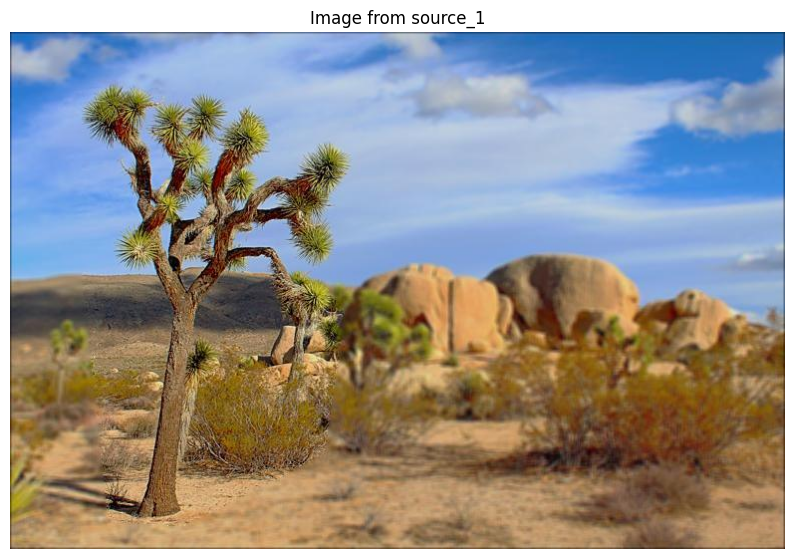

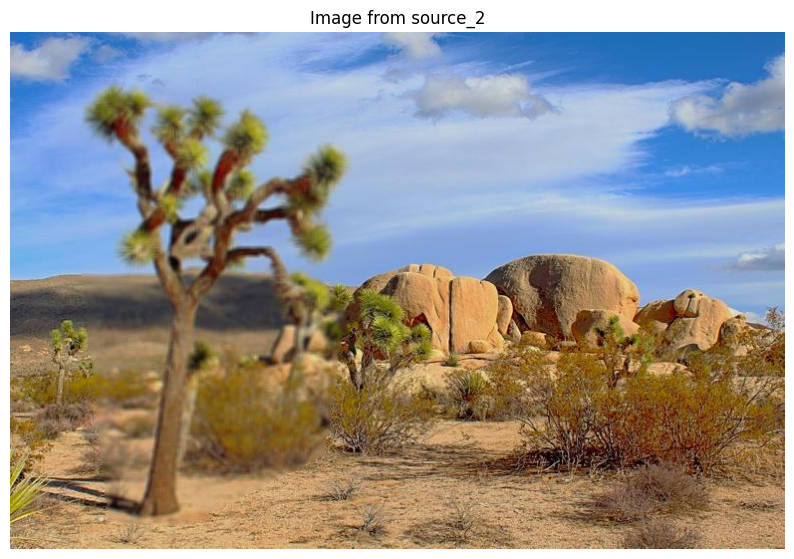

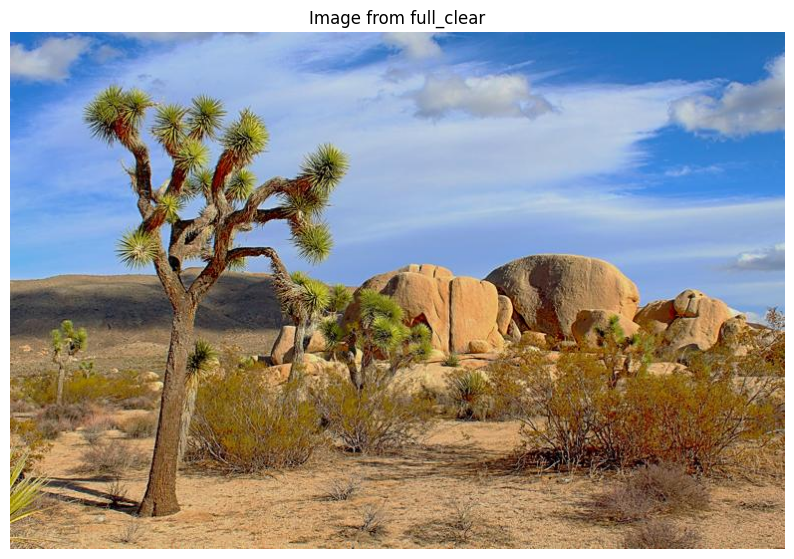

In [5]:
def display_images(base_path, folders):
    found_images = False
    for folder in folders:
        image_path = os.path.join(base_path, folder, '1.jpg')
        if os.path.exists(image_path):
            img = Image.open(image_path)
            plt.figure(figsize=(10, 10))
            plt.imshow(img)
            plt.title(f"Image from {folder}")
            plt.axis('off')
            plt.show()
            found_images = True
    
    if not found_images:
        print("Image '1.jpg' not found in any of the specified folders.")

# Base path to the MFI-WHU folder
base_path = '/kaggle/working/images/MFI-WHU'

# List of folders to search
folders = ['source_1', 'source_2', 'full_clear']

# Call the function to display the images
display_images(base_path, folders)

In [6]:
base_path = '/kaggle/working/images/MFI-WHU'
source1_path = os.path.join(base_path, 'source_1')
source2_path = os.path.join(base_path, 'source_2')
full_clear_path = os.path.join(base_path, 'full_clear')

In [7]:
class FusionDataset(Dataset):
    def __init__(self, image_pairs):
        self.image_pairs = image_pairs
        self.transform = transforms.Compose([
            transforms.Resize((256, 256)),
            transforms.ToTensor()
        ])

    def __len__(self):
        return len(self.image_pairs)

    def __getitem__(self, idx):
        source1_path, source2_path, full_clear_path = self.image_pairs[idx]
        source1 = self.transform(Image.open(source1_path))
        source2 = self.transform(Image.open(source2_path))
        full_clear = self.transform(Image.open(full_clear_path))
        return torch.cat((source1, source2), dim=0), full_clear


In [8]:
class FusionNet(nn.Module):
    def __init__(self):
        super(FusionNet, self).__init__()
        self.encoder = nn.Sequential(
            self.conv_block(6, 64),
            self.conv_block(64, 128),
            self.conv_block(128, 256)
        )
        self.decoder = nn.Sequential(
            self.conv_block(256, 128),
            self.conv_block(128, 64),
            nn.Conv2d(64, 3, kernel_size=3, padding=1),
            nn.Sigmoid()
        )

    def conv_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        features = self.encoder(x)
        return self.decoder(features)


In [9]:
image_pairs = []
for i in range(1, 121):  # Assuming 120 images numbered from 1 to 120
    source1 = os.path.join(source1_path, f'{i}.jpg')
    source2 = os.path.join(source2_path, f'{i}.jpg')
    full_clear = os.path.join(full_clear_path, f'{i}.jpg')
    image_pairs.append((source1, source2, full_clear))

In [10]:
train_pairs, test_pairs = train_test_split(image_pairs, test_size=0.2, random_state=42)

In [11]:
train_dataset = FusionDataset(train_pairs)
test_dataset = FusionDataset(test_pairs)
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=1)

In [12]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = FusionNet().to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters())

In [14]:
def evaluate_fusion(fused, ground_truth):
    fused = fused.cpu().numpy().transpose(1, 2, 0)
    ground_truth = ground_truth.cpu().numpy().transpose(1, 2, 0)
    
    # Print shape information for debugging
    print(f"Fused image shape: {fused.shape}")
    print(f"Ground truth image shape: {ground_truth.shape}")
    
    # Ensure the images are in the range [0, 1]
    fused = np.clip(fused, 0, 1)
    ground_truth = np.clip(ground_truth, 0, 1)
    
    # Use a smaller window size
    min_dim = min(fused.shape[0], fused.shape[1])
    win_size = min(7, min_dim - (min_dim % 2) + 1)  # Ensure odd window size
    
    return ssim(fused, ground_truth, win_size=win_size, channel_axis=2, data_range=1.0)



Epoch [1/30]
Training Loss after epoch 1: 0.0034

Epoch [2/30]
Training Loss after epoch 2: 0.0023

Epoch [3/30]
Training Loss after epoch 3: 0.0021

Epoch [4/30]
Training Loss after epoch 4: 0.0024

Epoch [5/30]
Training Loss after epoch 5: 0.0017

Epoch [6/30]
Training Loss after epoch 6: 0.0031

Epoch [7/30]
Training Loss after epoch 7: 0.0024

Epoch [8/30]
Training Loss after epoch 8: 0.0021

Epoch [9/30]
Training Loss after epoch 9: 0.0038

Epoch [10/30]
Training Loss after epoch 10: 0.0015

Epoch [11/30]
Training Loss after epoch 11: 0.0019

Epoch [12/30]
Training Loss after epoch 12: 0.0026

Epoch [13/30]
Training Loss after epoch 13: 0.0014

Epoch [14/30]
Training Loss after epoch 14: 0.0021

Epoch [15/30]
Training Loss after epoch 15: 0.0026

Epoch [16/30]
Training Loss after epoch 16: 0.0015

Epoch [17/30]
Training Loss after epoch 17: 0.0013

Epoch [18/30]
Training Loss after epoch 18: 0.0030

Epoch [19/30]
Training Loss after epoch 19: 0.0016

Epoch [20/30]
Training Loss a

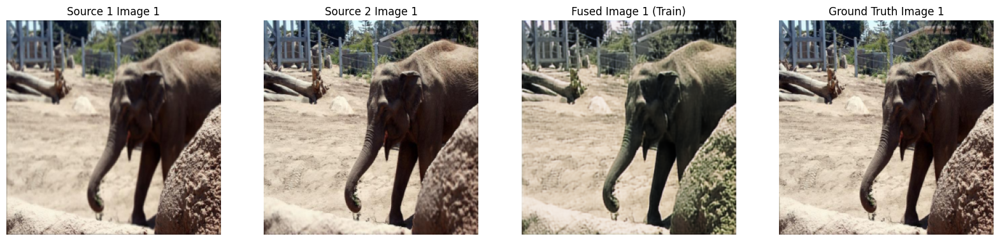

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 2, SSIM score: 0.9097082614898682


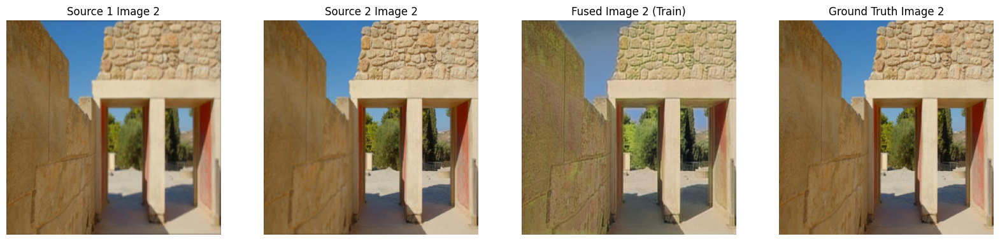

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 3, SSIM score: 0.8922029137611389


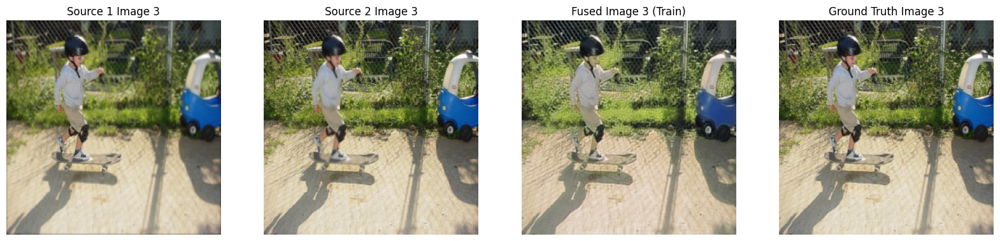

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 4, SSIM score: 0.9575745463371277


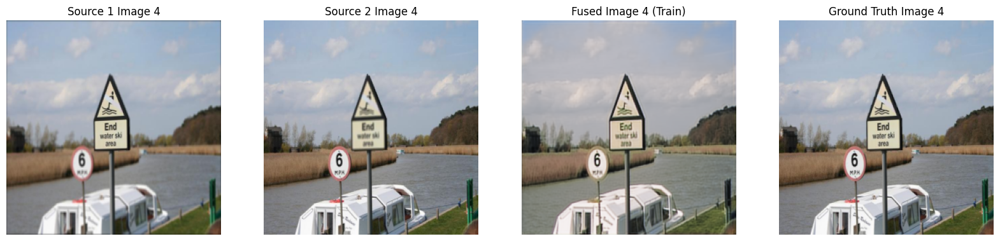

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 5, SSIM score: 0.915482223033905


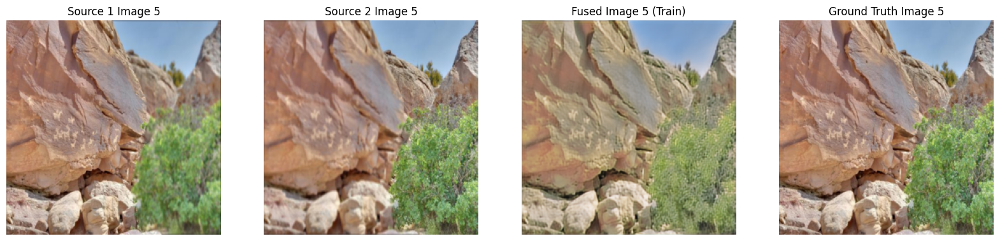

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 6, SSIM score: 0.9500533938407898


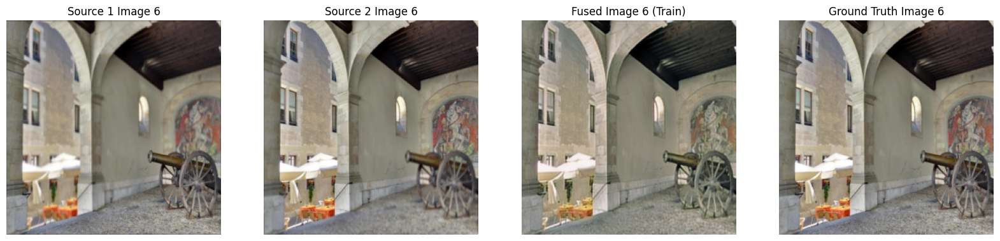

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 7, SSIM score: 0.9532711505889893


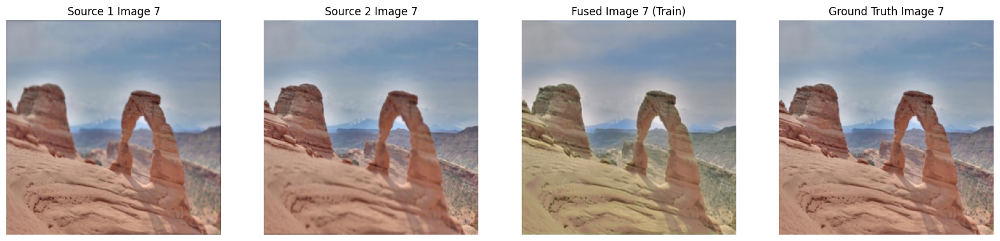

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 8, SSIM score: 0.9600017666816711


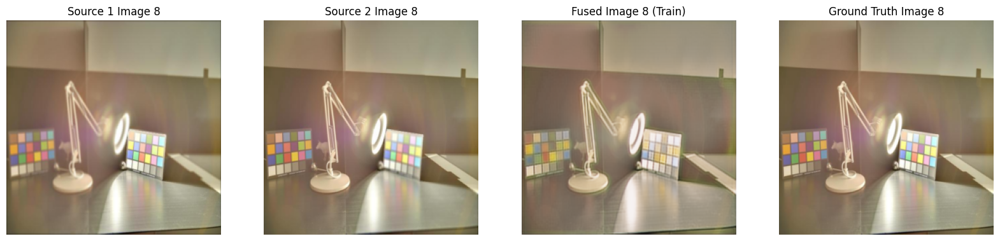

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 9, SSIM score: 0.9271628260612488


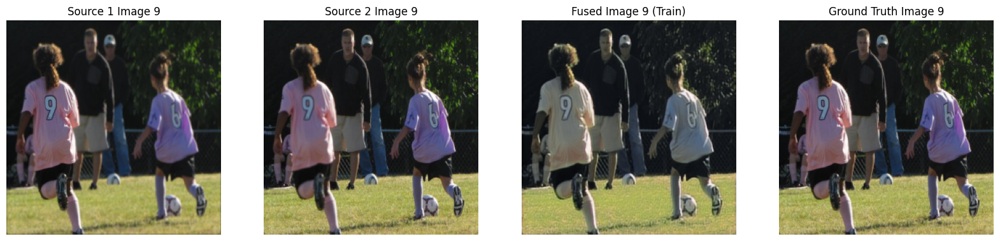

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 10, SSIM score: 0.9679387211799622


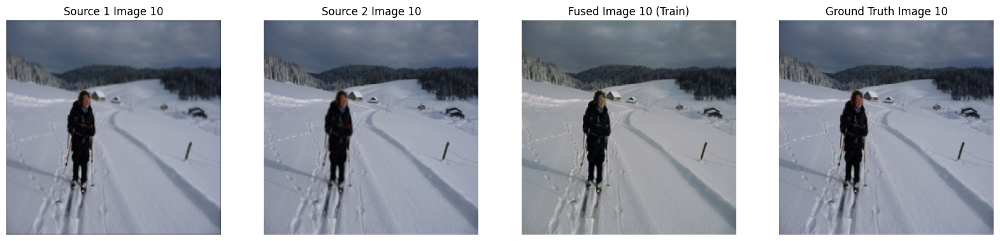

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 11, SSIM score: 0.7960338592529297


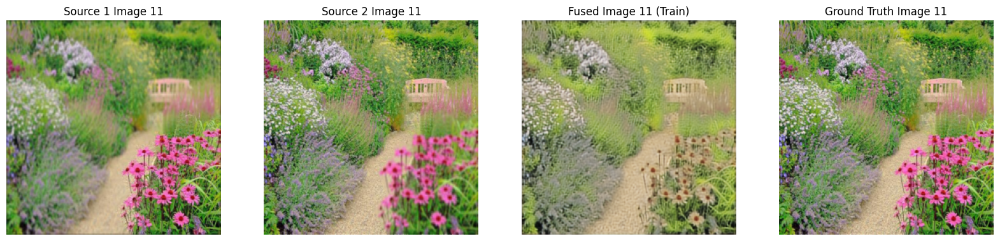

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 12, SSIM score: 0.9139907956123352


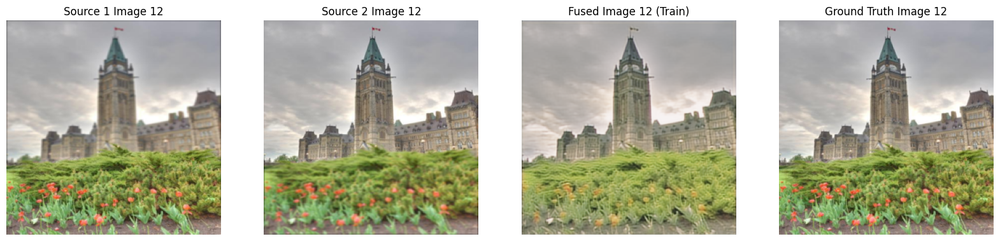

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 13, SSIM score: 0.9443336129188538


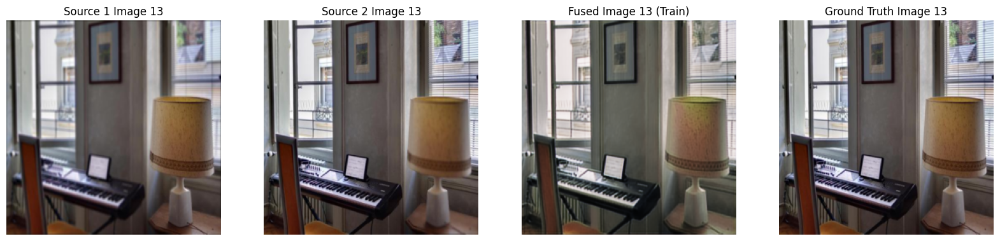

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 14, SSIM score: 0.9177361130714417


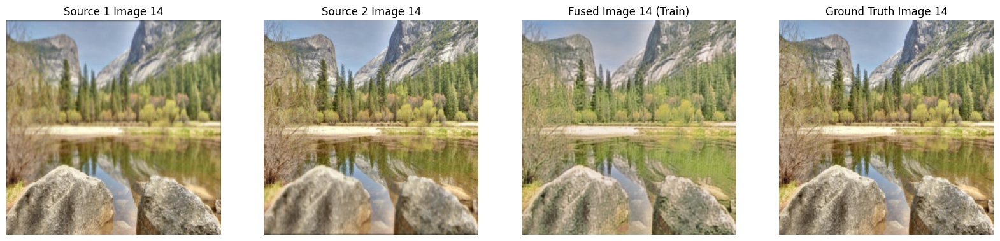

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 15, SSIM score: 0.9387848973274231


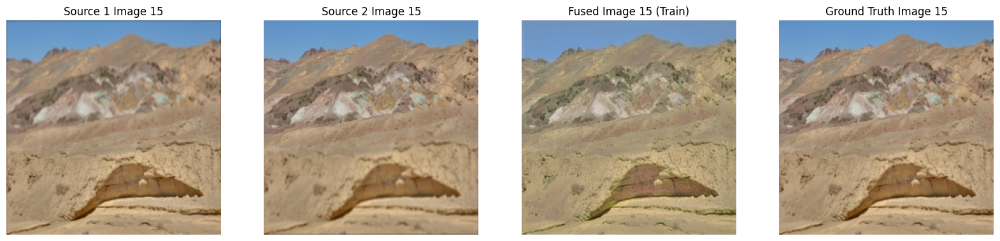

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 16, SSIM score: 0.8556523323059082


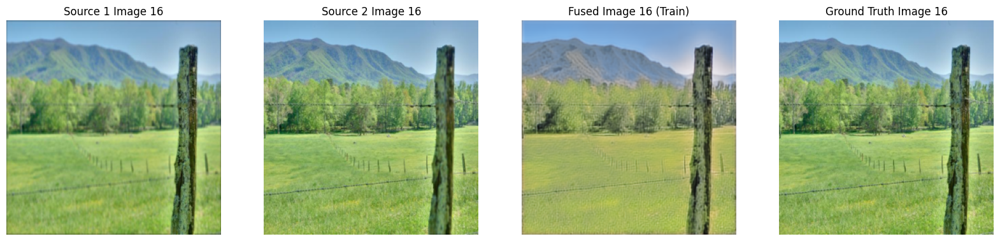

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 17, SSIM score: 0.9249188899993896


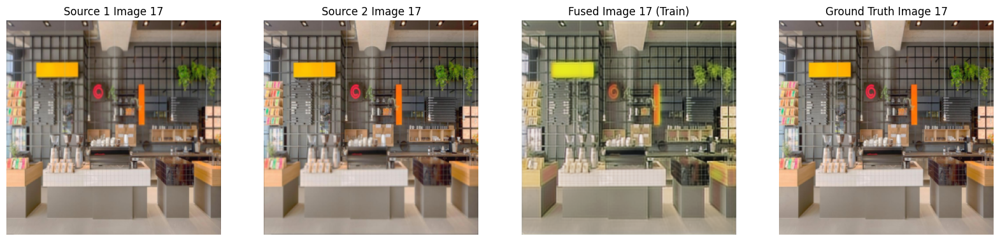

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 18, SSIM score: 0.8759309649467468


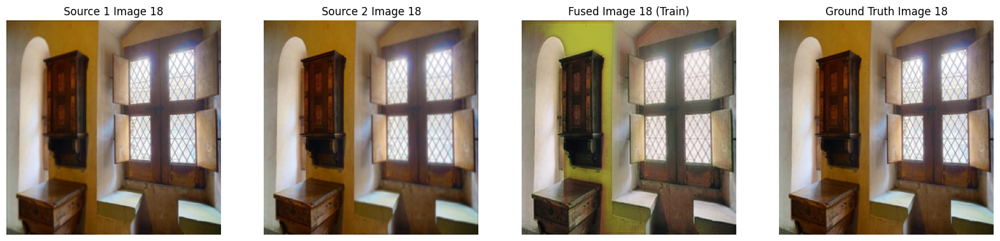

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 19, SSIM score: 0.9560770392417908


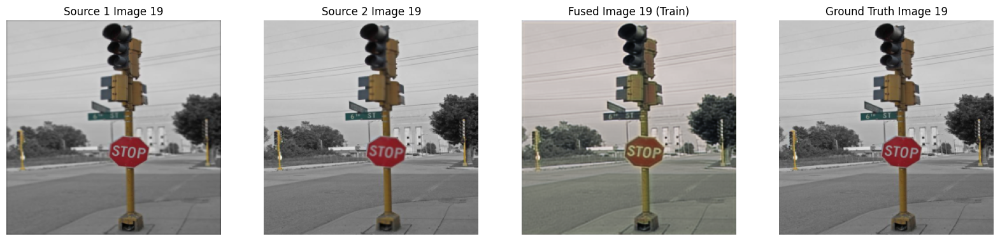

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 20, SSIM score: 0.9475419521331787


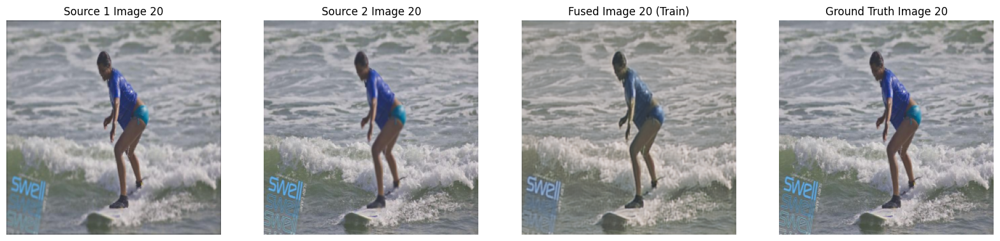

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 21, SSIM score: 0.9113319516181946


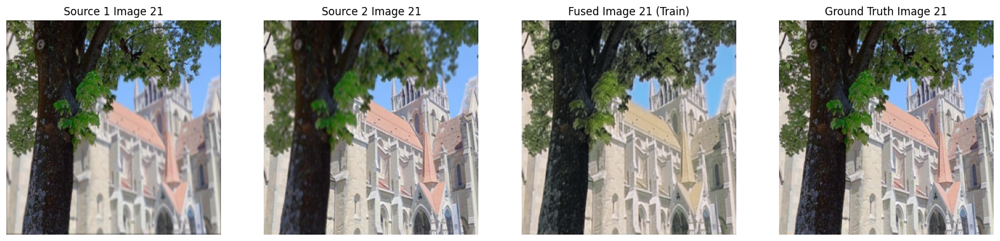

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 22, SSIM score: 0.9331104159355164


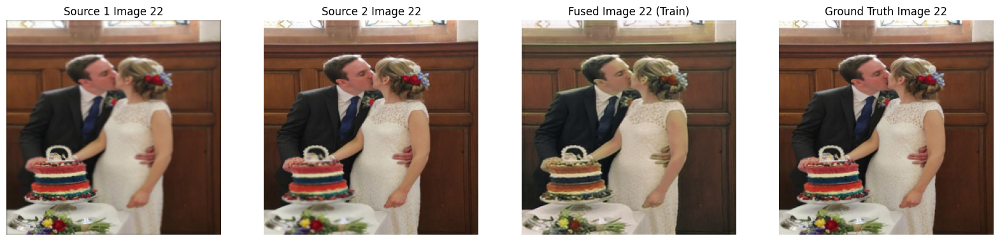

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 23, SSIM score: 0.9216358065605164


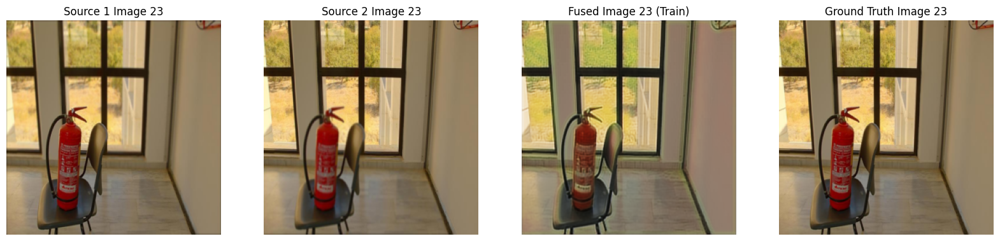

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Train image 24, SSIM score: 0.9406079649925232


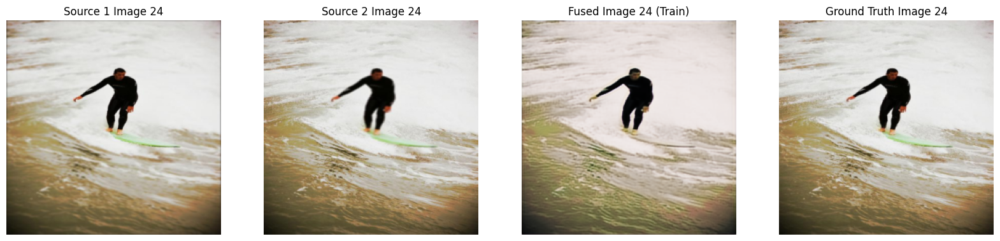


Average SSIM on Train set: 0.9224

--- Evaluating on Testing Set ---
Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 1, SSIM score: 0.9134604334831238


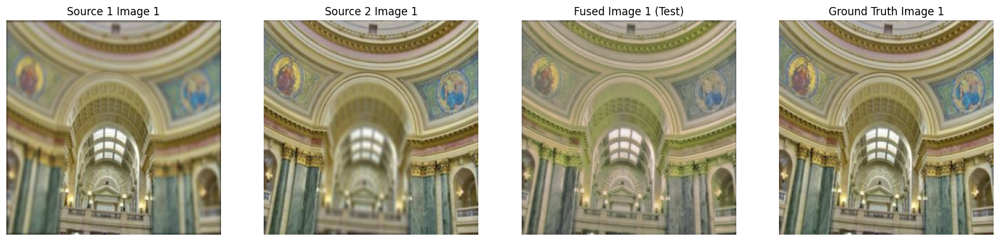

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 2, SSIM score: 0.9433204531669617


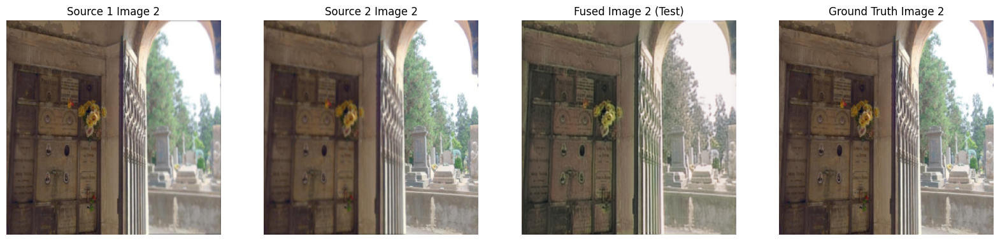

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 3, SSIM score: 0.9251747131347656


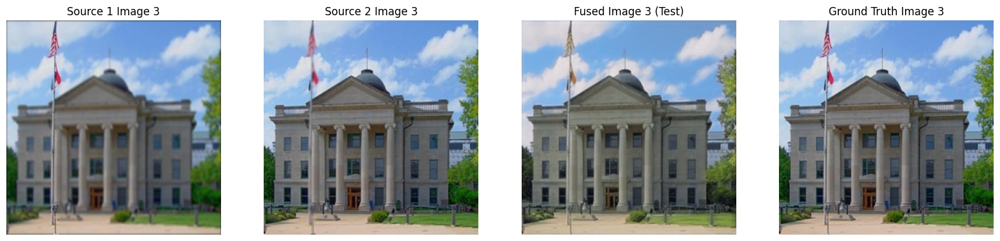

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 4, SSIM score: 0.9052608609199524


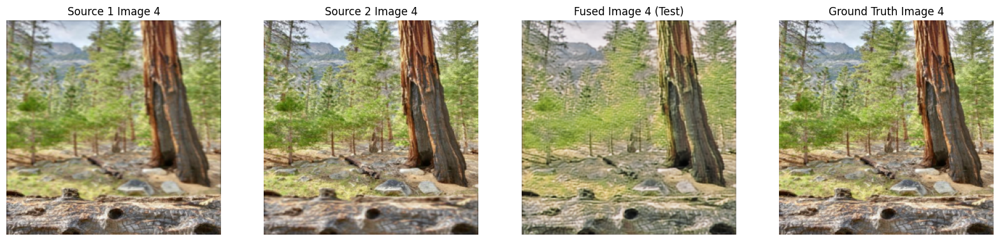

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 5, SSIM score: 0.9453819394111633


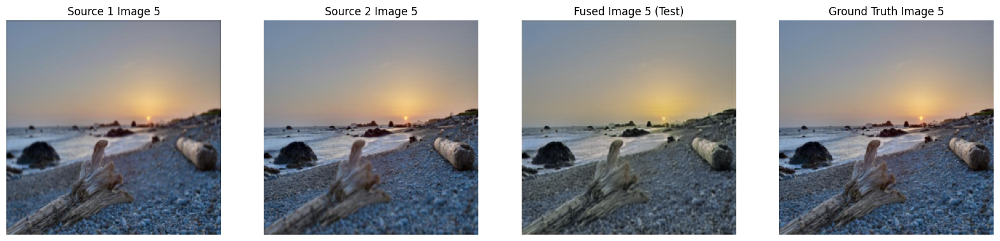

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 6, SSIM score: 0.9217776656150818


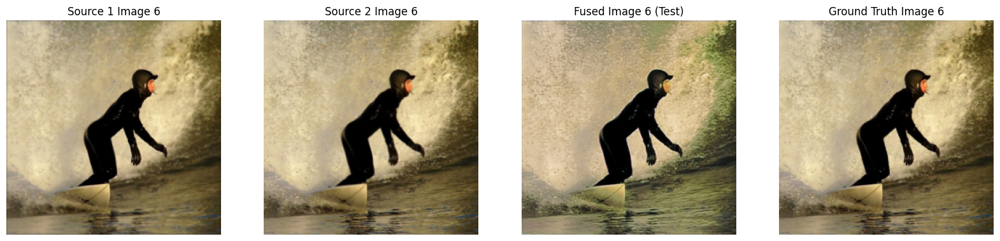

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 7, SSIM score: 0.9464418292045593


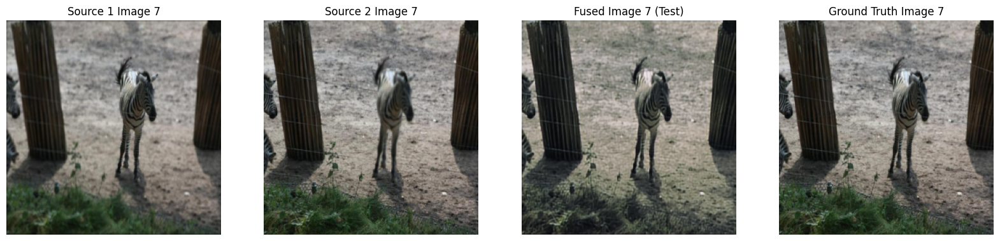

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 8, SSIM score: 0.8822393417358398


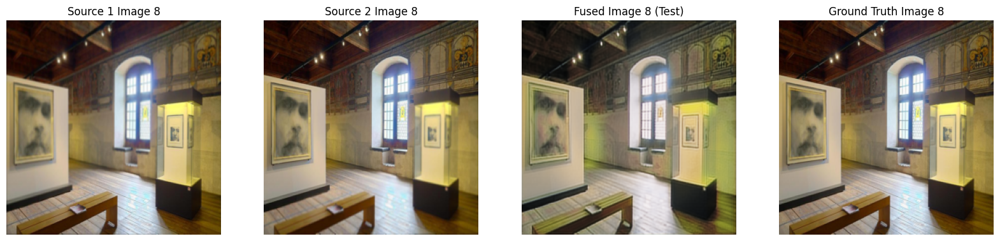

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 9, SSIM score: 0.9193205833435059


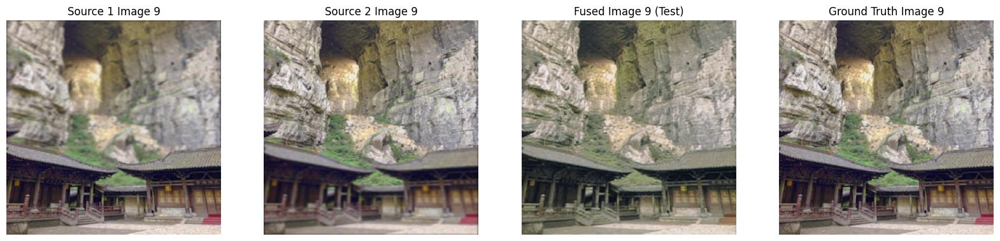

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 10, SSIM score: 0.9795940518379211


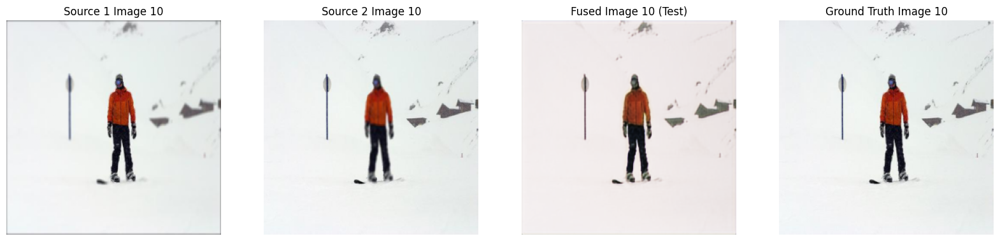

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 11, SSIM score: 0.96079021692276


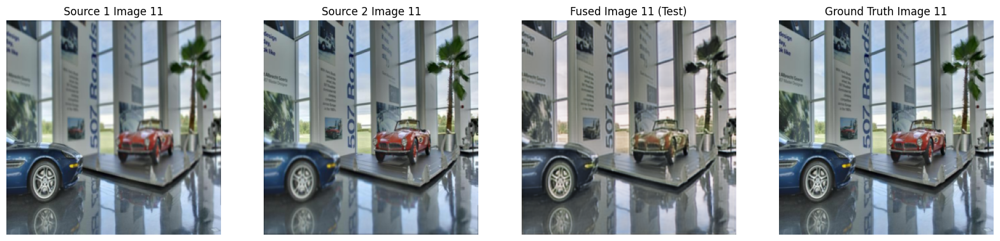

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 12, SSIM score: 0.8984325528144836


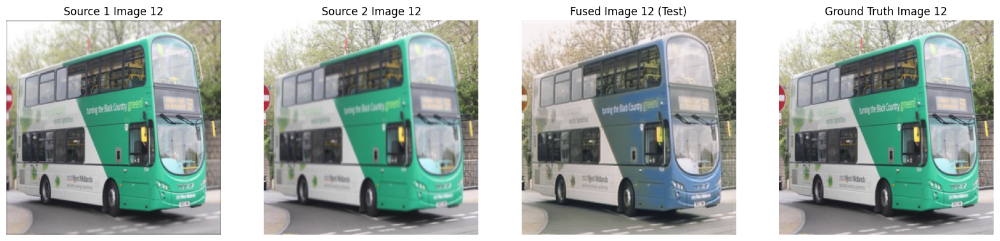

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 13, SSIM score: 0.8328198790550232


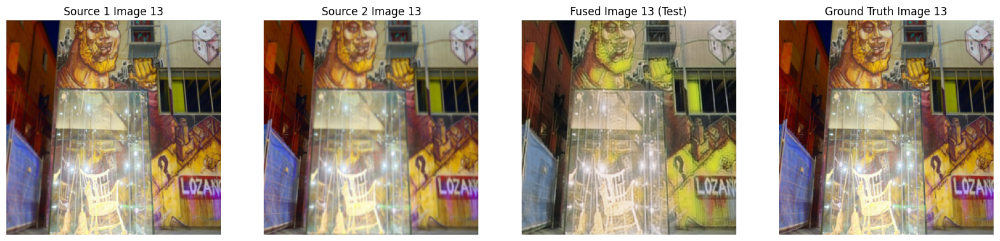

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 14, SSIM score: 0.9486737847328186


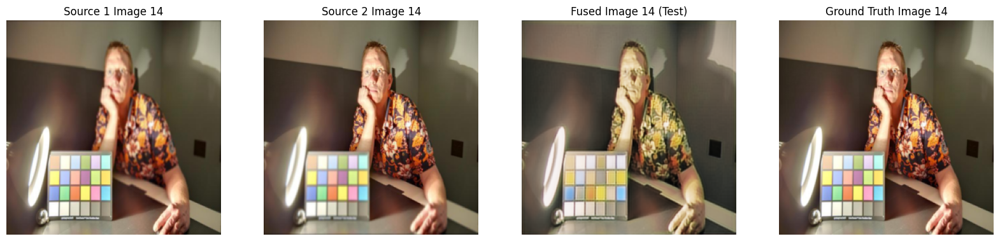

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 15, SSIM score: 0.9308225512504578


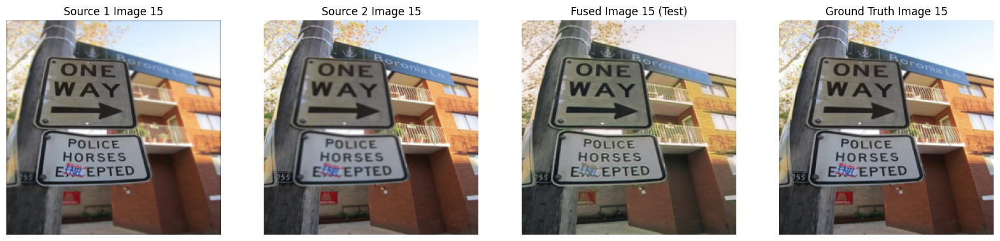

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 16, SSIM score: 0.9044897556304932


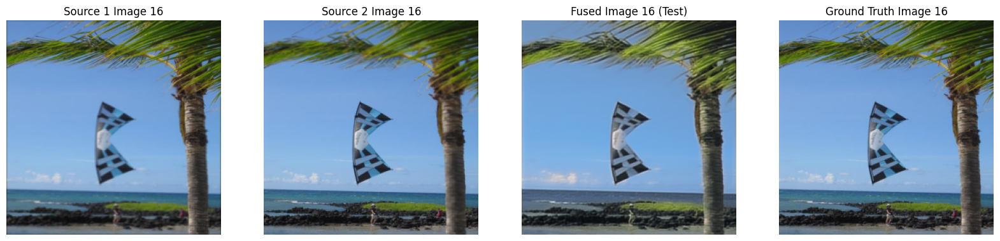

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 17, SSIM score: 0.95613694190979


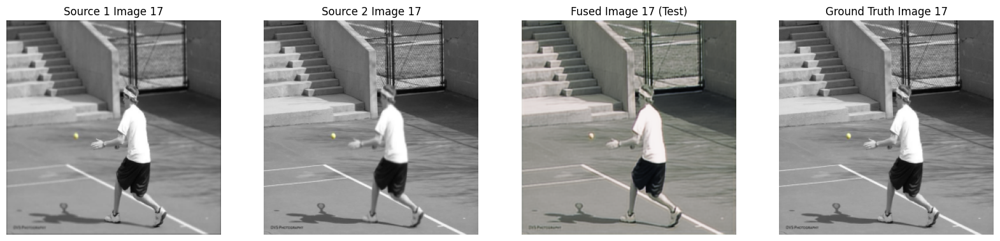

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 18, SSIM score: 0.8776686787605286


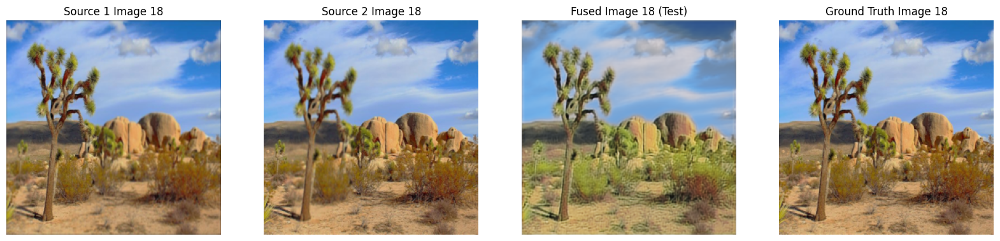

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 19, SSIM score: 0.9488868713378906


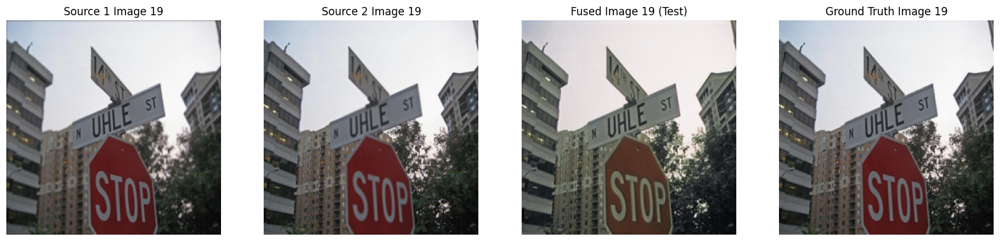

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 20, SSIM score: 0.9202248454093933


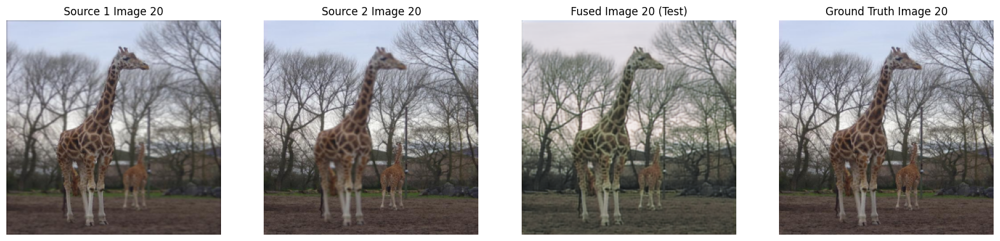

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 21, SSIM score: 0.931230366230011


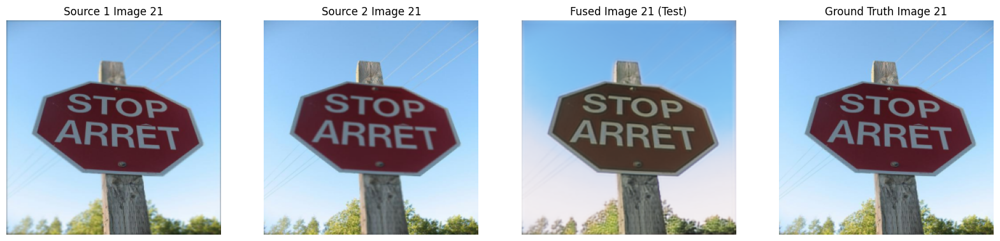

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 22, SSIM score: 0.8714911937713623


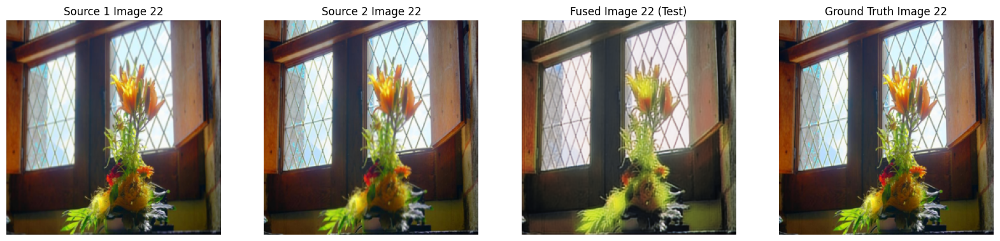

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 23, SSIM score: 0.9486528038978577


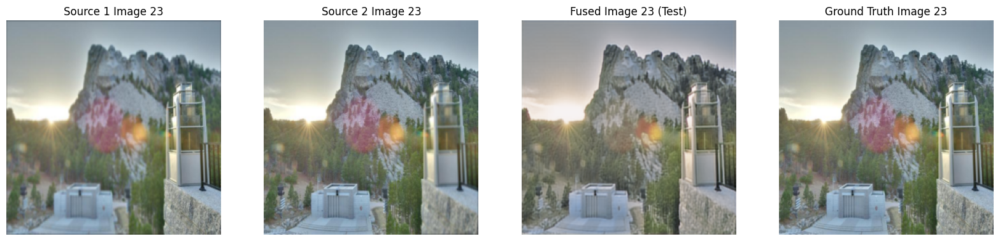

Fused image shape: (256, 256, 3)
Ground truth image shape: (256, 256, 3)
Test image 24, SSIM score: 0.8472090363502502


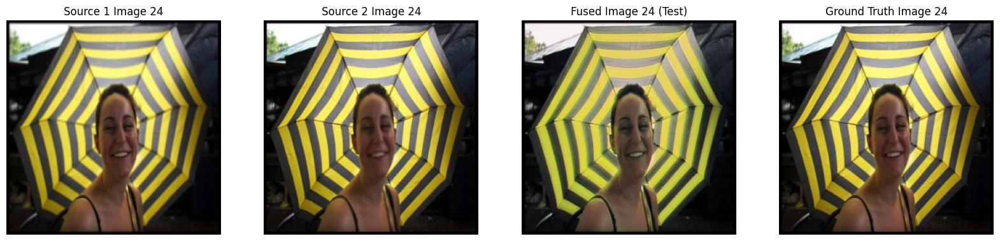


Average SSIM on Test set: 0.9191


In [15]:
# Function to compare and display the images side by side
def compare_images(source1, source2, fused, ground_truth, idx, phase="Train"):
    source1_img = source1.cpu().numpy().transpose(1, 2, 0)
    source2_img = source2.cpu().numpy().transpose(1, 2, 0)
    fused_img = fused.cpu().numpy().transpose(1, 2, 0)
    ground_truth_img = ground_truth.cpu().numpy().transpose(1, 2, 0)
    
    # Ensure the pixel values are in the range [0, 1]
    source1_img = np.clip(source1_img, 0, 1)
    source2_img = np.clip(source2_img, 0, 1)
    fused_img = np.clip(fused_img, 0, 1)
    ground_truth_img = np.clip(ground_truth_img, 0, 1)
    
    # Plot the images side by side for comparison
    fig, axs = plt.subplots(1, 4, figsize=(20, 6))
    
    axs[0].imshow(source1_img)
    axs[0].set_title(f'Source 1 Image {idx}')
    axs[0].axis('off')
    
    axs[1].imshow(source2_img)
    axs[1].set_title(f'Source 2 Image {idx}')
    axs[1].axis('off')
    
    axs[2].imshow(fused_img)
    axs[2].set_title(f'Fused Image {idx} ({phase})')
    axs[2].axis('off')
    
    axs[3].imshow(ground_truth_img)
    axs[3].set_title(f'Ground Truth Image {idx}')
    axs[3].axis('off')
    
    plt.show()

# Function to evaluate SSIM scores for accuracy
def evaluate_ssim(loader, phase="Test"):
    ssim_scores = []
    
    with torch.no_grad():
        for i, (inputs, targets) in enumerate(loader):
            inputs, targets = inputs.to(device), targets.to(device)
            source1, source2 = torch.split(inputs, 3, dim=1)  # Split the concatenated input back to source images
            fused = model(inputs)
            
            # Calculate SSIM
            ssim_score = evaluate_fusion(fused[0], targets[0])
            ssim_scores.append(ssim_score)
            print(f"{phase} image {i+1}, SSIM score: {ssim_score}")
            
            # Display the images side by side
            compare_images(source1[0], source2[0], fused[0], targets[0], i+1, phase=phase)
    
    # Return the average SSIM score for the dataset
    average_ssim = np.mean(ssim_scores)
    print(f"\nAverage SSIM on {phase} set: {average_ssim:.4f}")
    return average_ssim

# Function to train the model and calculate SSIM on the training set
def train_and_evaluate(train_loader, test_loader, num_epochs=30):
    for epoch in range(num_epochs):
        model.train()
        print(f"\nEpoch [{epoch+1}/{num_epochs}]")

        # Training loop
        for i, (inputs, targets) in enumerate(train_loader):
            inputs, targets = inputs.to(device), targets.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
        
        print(f"Training Loss after epoch {epoch+1}: {loss.item():.4f}")
    
    # Evaluate training accuracy using SSIM scores
    print("\n--- Evaluating on Training Set ---")
    train_ssim = evaluate_ssim(train_loader, phase="Train")
    
    # Evaluate testing accuracy using SSIM scores
    print("\n--- Evaluating on Testing Set ---")
    test_ssim = evaluate_ssim(test_loader, phase="Test")

# Call the function to start training and evaluation
train_and_evaluate(train_loader, test_loader)
